# Detection of AI Generated Images

In [ ]:
import os
import tensorflow as tf
import tensorflow.keras as keras
import numpy as np
from tensorflow.keras import layers, models , Sequential, optimizers
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, GlobalAveragePooling2D ,RandomFlip , RandomBrightness, RandomContrast, RandomRotation, RandomZoom, BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.models import load_model
# import resnet50 
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import MobileNetV3Small, MobileNetV3Large
from keras.optimizers import RMSprop, AdamW
from keras.optimizers import RMSprop, Adam
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import Callback
import cv2
import ipyplot


### Transfer learning with Resnet50 mode

In [2]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(128, 128, 3))
inp = keras.layers.Input(shape=(128,128,3))
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(128, 128, 3) , input_tensor=inp)
base_model.trainable = False

# print weights and trainable parameters


x = base_model.get_layer('conv5_block3_3_conv').output
x = GlobalAveragePooling2D()(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(1, activation='sigmoid')(x)

model  =  tf.keras.models.Model(inputs = inp, outputs=output)

print("weights:", len(model.weights))
print("trainable_weights:", len(model.trainable_weights))

# Compile the model learning_rate=1e-3, weight_decay=0.0001
model.compile(optimizer=AdamW(learning_rate=5e-2),
              loss='binary_crossentropy',
              metrics=['accuracy'])

2024-04-04 02:04:47.731107: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:07:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-04 02:04:48.026883: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:07:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-04 02:04:48.026973: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:07:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-04 02:04:48.028861: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:887] could not open file to read NUMA node: /sys/bus/pci/devices/0000:07:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-04-04 02:04:48.028917: I external/local_xla/xla/stream_executor

weights: 322
trainable_weights: 6


In [3]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 134, 134, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 64, 64, 64)           9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 64, 64, 64)           256       ['conv1_conv[0][0]']          
 on)                                                                                          

In [4]:
batch_size = 128
train_data_dir = './dataset/generated_images2/'
train_datagen = ImageDataGenerator(rescale=1./255,
                                    # rotation_range=40,
                                    # width_shift_range=0.2,
                                    # height_shift_range=0.2,
                                    # shear_range=0.2,
                                    # zoom_range=0.2,
                                    # horizontal_flip=True,
                                    validation_split=0.2) # set validation split

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    shuffle=True,
    target_size=(128, 128),
    batch_size=batch_size,
    class_mode='binary',
    subset='training') # set as validation data


validation_datagen = ImageDataGenerator(rescale=1./255,
                                        validation_split=0.2)


validation_generator = validation_datagen.flow_from_directory(
    train_data_dir,
    target_size=(128, 128),
    shuffle=True,
    batch_size=batch_size,
    class_mode='binary',
    subset='validation') # set as validation data



Found 1997392 images belonging to 2 classes.
Found 499346 images belonging to 2 classes.


### GradCam to view model progression

In [5]:


class GradCAM:
    def __init__(self, model, layerName):
        self.model = model
        self.layerName = layerName

        self.gradModel = tf.keras.models.Model(inputs=[self.model.inputs],
                                               outputs=[self.model.get_layer(self.layerName).output, self.model.output])

    def compute_heatmap(self, image, classIdx, eps=1e-8):
        with tf.GradientTape() as tape:
            tape.watch(self.gradModel.get_layer(self.layerName).variables)
            inputs = tf.cast(image, tf.float32)
            (convOutputs, predictions) = self.gradModel(inputs)

            if len(predictions) == 1:
                # Binary Classification
                loss = predictions[0]
            else:
                loss = predictions[:, classIdx]

        grads = tape.gradient(loss, convOutputs)

        castConvOutputs = tf.cast(convOutputs > 0, "float32")
        castGrads = tf.cast(grads > 0, "float32")
        guidedGrads = castConvOutputs * castGrads * grads

        convOutputs = convOutputs[0]
        guidedGrads = guidedGrads[0]

        weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
        cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)

        (w, h) = (image.shape[2], image.shape[1])
        heatmap = cv2.resize(cam.numpy(), (w, h))

        numer = heatmap - np.min(heatmap)
        denom = (heatmap.max() - heatmap.min()) + eps
        heatmap = numer / denom
        heatmap = (heatmap * 255).astype("uint8")

        return heatmap


    def overlay_heatmap(self, heatmap, image, alpha=0.5, colormap=cv2.COLORMAP_HOT):
        heatmap = cv2.applyColorMap(heatmap, colormap)
        output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)

        return (heatmap, output)


class GRADCamLogger(tf.keras.callbacks.Callback):
    def __init__(self, validation_data,labels_ , layer_name):
        super(GRADCamLogger, self).__init__()
        self.validation_data = validation_data
        self.layer_name = layer_name
        self.labels_ = labels_

    def on_epoch_end(self, epoch, logs=None):
        images = []
        grad_cam = []
        ## Initialize GRADCam Class
        cam = GradCAM(model, self.layer_name)
        for image in self.validation_data:
            image = np.expand_dims(image, 0)
            pred = model.predict(image)
            classIDx = np.argmax(pred[0])

            ## Compute Heatmap
            heatmap = cam.compute_heatmap(image, classIDx)

            image = image.reshape(image.shape[1:])
            image = image * 255
            image = image.astype(np.uint8)
            ## Overlay heatmap on original image
            heatmap = cv2.resize(heatmap, (image.shape[0], image.shape[1]))
            (heatmap, output) = cam.overlay_heatmap(heatmap, image, alpha=0.5)
            images.append(image)
            grad_cam.append(output)
        ipyplot.plot_images(images[:10], max_images=100, img_width=128 , labels = self.labels_[:10])
        ipyplot.plot_images(grad_cam[:10], max_images=100, img_width=128 ,  labels = self.labels_[:10])

15605
3902
128



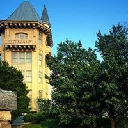
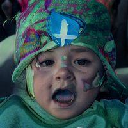
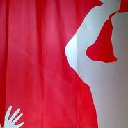
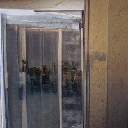
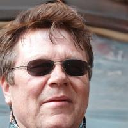
...
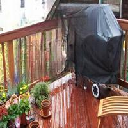
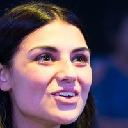
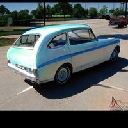
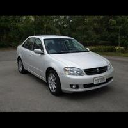
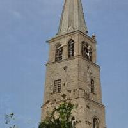

In [6]:
sample_images ,  sample_labels , sample_2 , dx = 0,0,0,0

print(len(train_generator))
print((len(validation_generator)))
sample_images, sample_labels = train_generator[200]
sample_images.shape, sample_labels.shape
sample_2 , dx =  train_generator[123]
print(len(sample_images))
ipyplot.plot_images(sample_images[:10], max_images=100, img_width=128 , labels=sample_labels[:10])
sample_images = sample_images[:10]

sample_labels=sample_labels[:10]

### Setting Checkpoints

In [7]:
from keras.callbacks import ModelCheckpoint , ReduceLROnPlateau

checkpoint_path = "./checkpoints/Resnet50_final_nt_model/"
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)
checkpoint_filename = "model_epoch{epoch:02d}.h5"

myCallback = ModelCheckpoint(
    os.path.join(checkpoint_path, checkpoint_filename),
    monitor='val_loss',  # You can change this to monitor other metrics
    save_best_only=False,  # Set to True if you only want to save the best model
    save_weights_only=False,  # Set to True if you only want to save the model weights
    verbose=1
)

reduce_lr = ReduceLROnPlateau(factor=0.5, patience=2, min_lr=0.000005)

## Model Training 

base_model.trainable = False

trainable_weights: 6

Epoch 1/10


2024-03-23 01:25:14.339049: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-03-23 01:25:14.606316: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-23 01:25:15.358109: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-23 01:25:18.125028: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f585c78ec20 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-23 01:25:18.125064: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti SUPER, Compute Capability 8.9
2024-03-23 01:25:18.136220: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1711137318.229856     800 device_

15605/15605 [==============================] - ETA: 0s - loss: 0.6210 - accuracy: 0.6441
Epoch 1: saving model to ./checkpoints/Resnet50_final_nt_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 15ms/step



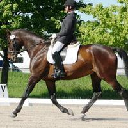
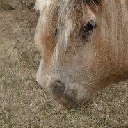
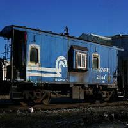
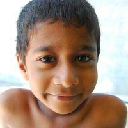
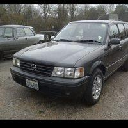
...
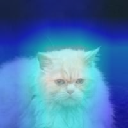
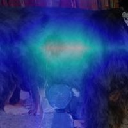
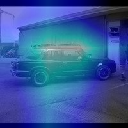
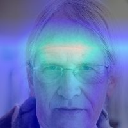
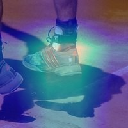

15605/15605 [==============================] - 14808s 949ms/step - loss: 0.6210 - accuracy: 0.6441 - val_loss: 0.6104 - val_accuracy: 0.6509 - lr: 0.0010
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.6147 - accuracy: 0.6478
Epoch 2: saving model to ./checkpoints/Resnet50_final_nt_model/model_epoch02.h5
1/1 [==============================] - 0s 14ms/step



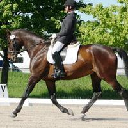
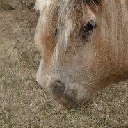
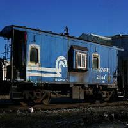
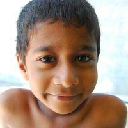
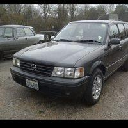
...
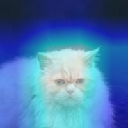
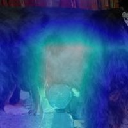
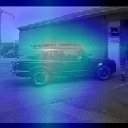
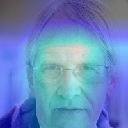
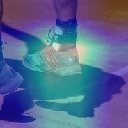

15605/15605 [==============================] - 14876s 953ms/step - loss: 0.6147 - accuracy: 0.6478 - val_loss: 0.6083 - val_accuracy: 0.6521 - lr: 0.0010
Epoch 3/10
  221/15605 [..............................] - ETA: 3:33:34 - loss: 0.6160 - accuracy: 0.6443

In [8]:

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 4),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 4),
    epochs = 10,
    callbacks = [reduce_lr,myCallback , GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv') ])

In [ ]:
model = load_model('./checkpoints/Resnet50_final_nt_model/model_epoch02.h5')
history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 4),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 4),
    epochs = 8,
    callbacks = [reduce_lr,myCallback , GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv') ])

Epoch 1/8


2024-03-29 00:50:31.606000: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-03-29 00:50:31.905678: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-29 00:50:32.711374: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-29 00:50:35.049912: I external/local_xla/xla/service/service.cc:168] XLA service 0x7fc23c31c420 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-29 00:50:35.049951: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti SUPER, Compute Capability 8.9
2024-03-29 00:50:35.061185: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1711653635.156245     786 device_

15605/15605 [==============================] - ETA: 0s - loss: 0.6306 - accuracy: 0.6347
Epoch 1: saving model to ./checkpoints/Resnet50_final_nt_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 15ms/step



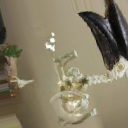
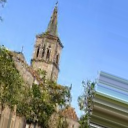
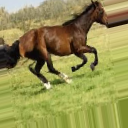
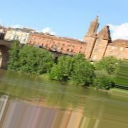
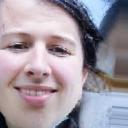
...
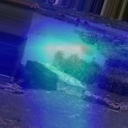
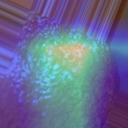
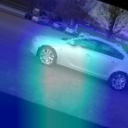
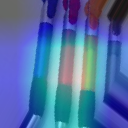
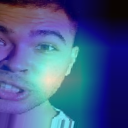

15605/15605 [==============================] - 17539s 1s/step - loss: 0.6306 - accuracy: 0.6347 - val_loss: 0.6139 - val_accuracy: 0.6470 - lr: 0.0010
Epoch 2/8
15605/15605 [==============================] - ETA: 0s - loss: 0.6289 - accuracy: 0.6362
Epoch 2: saving model to ./checkpoints/Resnet50_final_nt_model/model_epoch02.h5
1/1 [==============================] - 0s 15ms/step



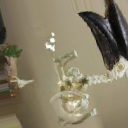
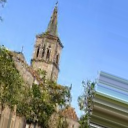
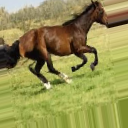
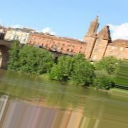
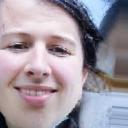
...
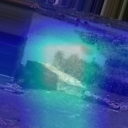
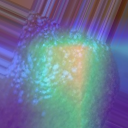
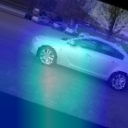
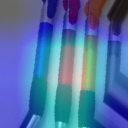
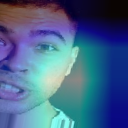

15605/15605 [==============================] - 17878s 1s/step - loss: 0.6289 - accuracy: 0.6362 - val_loss: 0.6142 - val_accuracy: 0.6463 - lr: 0.0010
Epoch 3/8
  282/15605 [..............................] - ETA: 4:29:21 - loss: 0.6294 - accuracy: 0.6358

In [7]:
model = load_model('./checkpoints/Resnet50_final_nt_model/model_epoch02.h5')
history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 4),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 4),
    epochs = 8,
    callbacks = [reduce_lr,myCallback , GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv') ])

## Fine tuning model

base_model.trainable = True

trainable_weights: 216

In [8]:

base_model.trainable = True
print("weights:", len(model.weights))
print("trainable_weights:", len(model.trainable_weights))

model.compile(
    optimizer=keras.optimizers.AdamW(1e-5),  # Low learning rate
    loss=keras.losses.BinaryCrossentropy(from_logits=True),
    metrics=[keras.metrics.BinaryAccuracy()],
)

weights: 322
trainable_weights: 216


In [8]:
checkpoint_path = "./checkpoints/Resnet50_final_t_model/"
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)
checkpoint_filename = "model_epoch{epoch:02d}.h5"

myCallback = ModelCheckpoint(
    os.path.join(checkpoint_path, checkpoint_filename),
    monitor='val_loss',  # You can change this to monitor other metrics
    save_best_only=False,  # Set to True if you only want to save the best model
    save_weights_only=False,  # Set to True if you only want to save the model weights
    verbose=1
)


### Training with low learning rate

Epoch 1/10


/home/viren/.local/lib/python3.10/site-packages/keras/src/backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
2024-03-30 01:03:14.511804: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-03-30 01:03:14.800221: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-30 01:03:15.321926: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-30 01:03:18.344216: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f98f48f8f10 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-30 01:03:18.344252: I external/local_xla/xla/service/service.cc:176]   StreamExecutor devi

15605/15605 [==============================] - ETA: 0s - loss: 0.5035 - binary_accuracy: 0.7333
Epoch 1: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 15ms/step



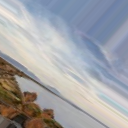
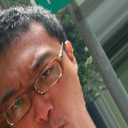
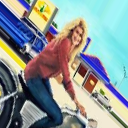
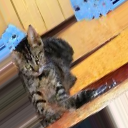
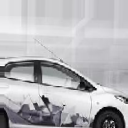
...
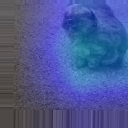
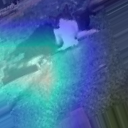
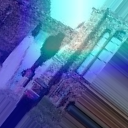
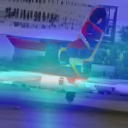
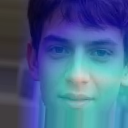

15605/15605 [==============================] - 18855s 1s/step - loss: 0.5035 - binary_accuracy: 0.7333 - val_loss: 0.6295 - val_binary_accuracy: 0.6983 - lr: 1.0000e-05
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.4026 - binary_accuracy: 0.8054
Epoch 2: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch02.h5
1/1 [==============================] - 0s 16ms/step



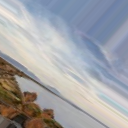
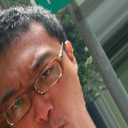
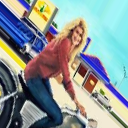
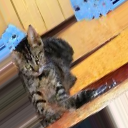
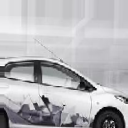
...
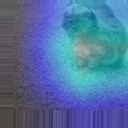
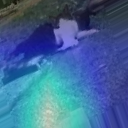
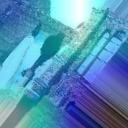
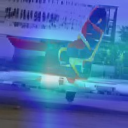
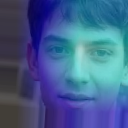

15605/15605 [==============================] - 19270s 1s/step - loss: 0.4026 - binary_accuracy: 0.8054 - val_loss: 0.5426 - val_binary_accuracy: 0.7574 - lr: 1.0000e-05
Epoch 3/10
  173/15605 [..............................] - ETA: 4:25:54 - loss: 0.3721 - binary_accuracy: 0.8237

In [11]:

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 16),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 16),
    epochs = 10,
    callbacks = [reduce_lr,myCallback ,GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv')])

Epoch 1/10


/home/viren/.local/lib/python3.10/site-packages/keras/src/backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
2024-03-31 01:00:20.173519: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-03-31 01:00:20.349942: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-31 01:00:20.718201: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-03-31 01:00:23.655031: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f9f204c1b50 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-31 01:00:23.655064: I external/local_xla/xla/service/service.cc:176]   StreamExecutor devi

15605/15605 [==============================] - ETA: 0s - loss: 0.3572 - binary_accuracy: 0.8336
Epoch 1: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 16ms/step



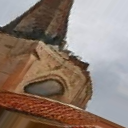
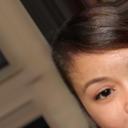
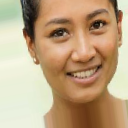
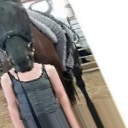
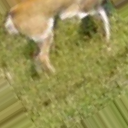
...
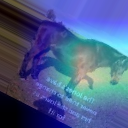
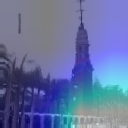
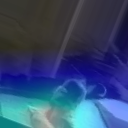
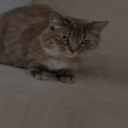
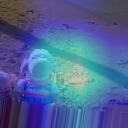

15605/15605 [==============================] - 18678s 1s/step - loss: 0.3572 - binary_accuracy: 0.8336 - val_loss: 0.5423 - val_binary_accuracy: 0.7703 - lr: 1.0000e-05
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.3275 - binary_accuracy: 0.8506
Epoch 2: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch02.h5
1/1 [==============================] - 0s 17ms/step



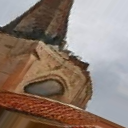
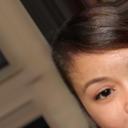
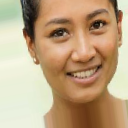
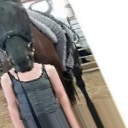
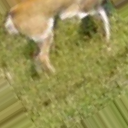
...
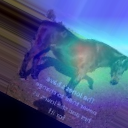
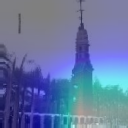
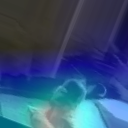
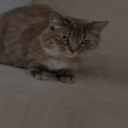
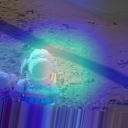

15605/15605 [==============================] - 19014s 1s/step - loss: 0.3275 - binary_accuracy: 0.8506 - val_loss: 0.5484 - val_binary_accuracy: 0.7818 - lr: 1.0000e-05
Epoch 3/10
   11/15605 [..............................] - ETA: 4:54:45 - loss: 0.3124 - binary_accuracy: 0.8558

In [11]:
model = load_model('./checkpoints/Resnet50_final_t_model/model_epoch02.h5')

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 16),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 16),
    epochs = 10,
    callbacks = [reduce_lr,myCallback ,GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv')])

Epoch 1/10


/home/viren/.local/lib/python3.10/site-packages/keras/src/backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
2024-04-01 00:15:08.311998: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-04-01 00:15:08.584658: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-01 00:15:09.354623: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-01 00:15:12.150617: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f67691ce990 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-04-01 00:15:12.150655: I external/local_xla/xla/service/service.cc:176]   StreamExecutor devi

15605/15605 [==============================] - ETA: 0s - loss: 0.3059 - binary_accuracy: 0.8625
Epoch 1: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 14ms/step



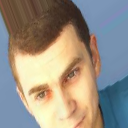
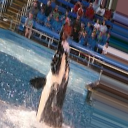
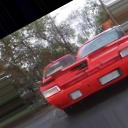
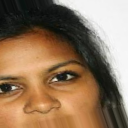
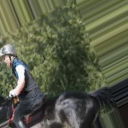
...
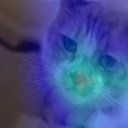
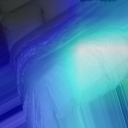
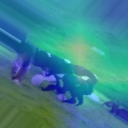
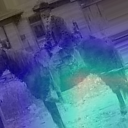
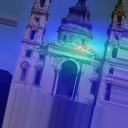

15605/15605 [==============================] - 17913s 1s/step - loss: 0.3059 - binary_accuracy: 0.8625 - val_loss: 0.5942 - val_binary_accuracy: 0.7751 - lr: 1.0000e-05
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.2884 - binary_accuracy: 0.8718
Epoch 2: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch02.h5
1/1 [==============================] - 0s 16ms/step



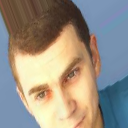
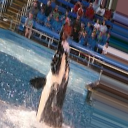
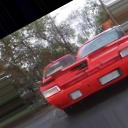
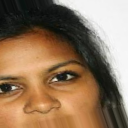
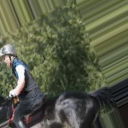
...
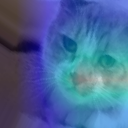
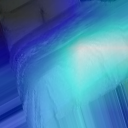
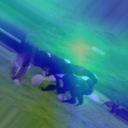
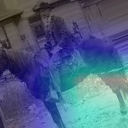
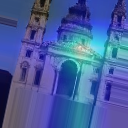

15605/15605 [==============================] - 18173s 1s/step - loss: 0.2884 - binary_accuracy: 0.8718 - val_loss: 0.5022 - val_binary_accuracy: 0.8127 - lr: 1.0000e-05
Epoch 3/10
   65/15605 [..............................] - ETA: 4:26:01 - loss: 0.2694 - binary_accuracy: 0.8826

In [11]:
model = load_model('./checkpoints/Resnet50_final_t_model/model_epoch02.h5')

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 16),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 16),
    epochs = 10,
    callbacks = [reduce_lr,myCallback ,GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv')])

Used the first model here as final model as it has lowest loss

Epoch 1/10


/home/viren/.local/lib/python3.10/site-packages/keras/src/backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
2024-04-03 00:37:56.974445: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-04-03 00:37:57.360601: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-03 00:37:58.014625: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-03 00:38:01.417581: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f0d9c810f10 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-04-03 00:38:01.417615: I external/local_xla/xla/service/service.cc:176]   StreamExecutor devi

15605/15605 [==============================] - ETA: 0s - loss: 0.2264 - binary_accuracy: 0.9030
Epoch 1: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 15ms/step



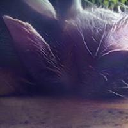
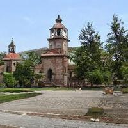
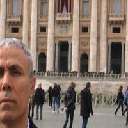
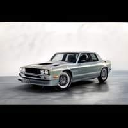
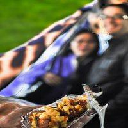
...
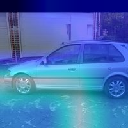
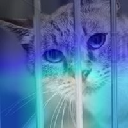
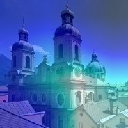
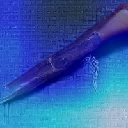
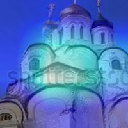

15605/15605 [==============================] - 14712s 941ms/step - loss: 0.2264 - binary_accuracy: 0.9030 - val_loss: 0.2263 - val_binary_accuracy: 0.9033 - lr: 1.0000e-05
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.1656 - binary_accuracy: 0.9317
Epoch 2: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch02.h5
1/1 [==============================] - 0s 15ms/step



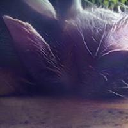
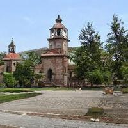
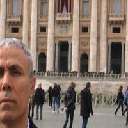
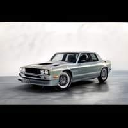
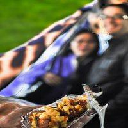
...
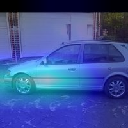
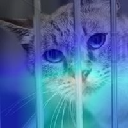
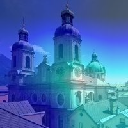
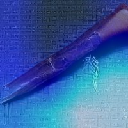
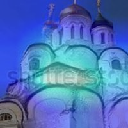

15605/15605 [==============================] - 14773s 947ms/step - loss: 0.1656 - binary_accuracy: 0.9317 - val_loss: 0.2428 - val_binary_accuracy: 0.9014 - lr: 1.0000e-05
Epoch 3/10
  583/15605 [>.............................] - ETA: 3:15:52 - loss: 0.1101 - binary_accuracy: 0.9557

In [9]:
model = load_model('./checkpoints/Resnet50_final_t_model/model_epoch02.h5')

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 16),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 16),
    epochs = 10,
    callbacks = [reduce_lr,myCallback ,GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv')])

Epoch 1/10


/home/viren/.local/lib/python3.10/site-packages/keras/src/backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(
2024-04-04 02:06:00.786295: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-04-04 02:06:01.079051: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-04 02:06:01.770797: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-04-04 02:06:04.533020: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f945437eed0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-04-04 02:06:04.533056: I external/local_xla/xla/service/service.cc:176]   StreamExecutor devi

15605/15605 [==============================] - ETA: 0s - loss: 0.1169 - binary_accuracy: 0.9532
Epoch 1: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch01.h5


/home/viren/.local/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 16ms/step



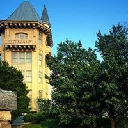
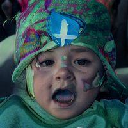
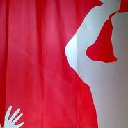
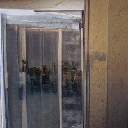
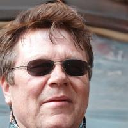
...
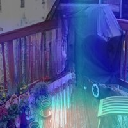
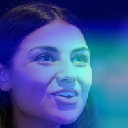
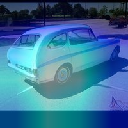
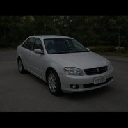
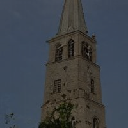

15605/15605 [==============================] - 13758s 880ms/step - loss: 0.1169 - binary_accuracy: 0.9532 - val_loss: 0.2474 - val_binary_accuracy: 0.9077 - lr: 1.0000e-05
Epoch 2/10
15605/15605 [==============================] - ETA: 0s - loss: 0.0781 - binary_accuracy: 0.9695
Epoch 2: saving model to ./checkpoints/Resnet50_final_t_model/model_epoch02.h5
1/1 [==============================] - 0s 16ms/step



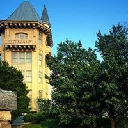
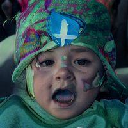
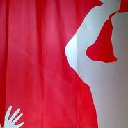
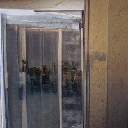
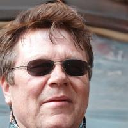
...
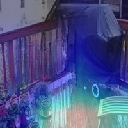
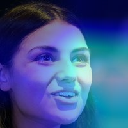
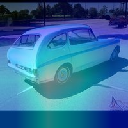
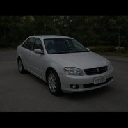
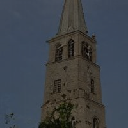

15605/15605 [==============================] - 14047s 900ms/step - loss: 0.0781 - binary_accuracy: 0.9695 - val_loss: 0.3047 - val_binary_accuracy: 0.9040 - lr: 1.0000e-05
Epoch 3/10
   37/15605 [..............................] - ETA: 3:21:52 - loss: 0.0484 - binary_accuracy: 0.9842

In [9]:
model = load_model('./checkpoints/Resnet50_final_t_model/model_epoch02.h5')

history = model.fit(
    train_generator,
    # steps_per_epoch = train_generator.samples() // (batch_size * 16),
    validation_data = validation_generator,
    # validation_steps = validation_generator.samples() // (batch_size * 16),
    epochs = 10,
    callbacks = [reduce_lr,myCallback ,GRADCamLogger(sample_images,sample_labels, layer_name='conv5_block3_3_conv')])